In [84]:
%matplotlib inline
import numpy as np
from IPython.display import Audio
import wave
import matplotlib.pyplot as plt

In this example, we are going to use an ideal lowpass filter to remove high frequency record player noise from an old audio recording.

In [85]:
Audio('data/freischutz.unprocessed.wav')

In [86]:
def read_sound(name):
    sound = wave.open(name, 'r')
    assert sound.getsampwidth() == 2
    x = np.array(np.frombuffer(sound.readframes(-1), dtype=np.int16), dtype=np.float)
    sr = sound.getframerate()
    return x, sr

def write_sound(name, x, sr):
    sound = wave.open(name, 'w')
    sound.setnchannels(1)
    sound.setsampwidth(2)
    sound.setframerate(sr)
    sound.writeframes(np.array(x, dtype=np.int16))
    

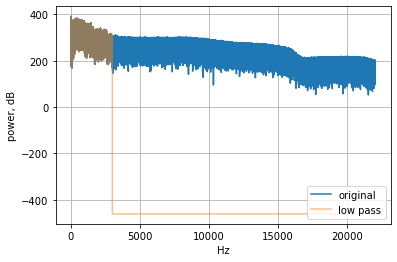

In [87]:
x, sr = read_sound('data/freischutz.unprocessed.wav')
T0 = len(x)/sr
ak = np.fft.rfft(x)
ak_low = np.copy(ak)
k = np.arange(0, len(ak))
ak_low[int(3000*T0):] = 1e-10
plt.plot(k/T0, 20*np.log(np.abs(ak)), label='original', alpha=1)
plt.plot(k/T0, 20*np.log(np.abs(ak_low)), label='low pass', alpha=0.5)
plt.legend(loc='lower right')
plt.xlabel('Hz')
plt.ylabel('power, dB')
plt.grid()

In [88]:
x_low = np.fft.irfft(ak_low)
x_high = x - x_low

beep, sr_beep = read_sound('data/beep-02.wav')
x_compare = np.copy(x)
d = sr*10
for i, start in enumerate(range(0, len(x), d)):
    if i%2 != 0:
        x_compare[start:start+d] = x_low[start:start+d]
    x_compare[start:start+len(beep)] += beep*1e-1
        
x_compare *= np.mean(x)/np.mean(x_compare)
write_sound('data/freischutz.compare.wav', x_compare, sr)
Audio('data/freischutz.compare.wav')

## Visualization of the DFFT at each time instant in the Recording

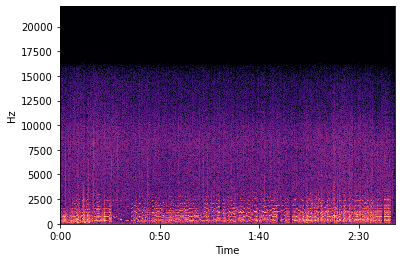

In [89]:
X = librosa.stft(x)
XdB = librosa.amplitude_to_db(abs(X))
librosa.display.specshow(XdB, sr=sr, x_axis='time', y_axis='hz')